**What is a Term Deposit ?**

A time deposit or term deposit is a deposit in a financial institution with a specific maturity date or a period to maturity, commonly referred to as its "term". Time deposits differ from at call deposits, such as savings or checking accounts, which can be withdrawn at any time, without any notice or penalty. Deposits that require notice of withdrawal to be given are effectively time deposits, though they do not have a fixed maturity date.

A term deposit is a fixed-term investment that includes the deposit of money into an account at a financial institution. Term deposit investments usually carry short-term maturities ranging from one month to a few years and will have varying levels of required minimum deposits.

The investor must understand when buying a term deposit that they can withdraw their funds only after the term ends. In some cases, the account holder may allow the investor early termination or withdrawal if they give several days notification. Also, there will be a penalty assessed for early termination.

**Problem Statement**

A retail bank has conducted a series of direct marketing campaigns via phone calls to promote term deposit subscriptions. The bank wants to use machine learning to predict whether a customer will subscribe to a term deposit based on demographic, financial, and campaign-related attributes.

**Objective**

To develop a classification model that accurately predicts the likelihood of a customer subscribing to a term deposit using historical campaign data. This can help the bank:
- Improve targeting for future campaigns.
- Reduce marketing costs.
- Increase campaign success rates.


# Importing libraries

In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
sns.set()
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# Importing Dataset

In [6]:
df = pd.read_excel('Banking_Call_Data.xlsx')

In [7]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


# Data Preprocessing and EDA

## Data Exploration

In [10]:
df.shape

(45211, 17)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [12]:
df.duplicated().sum()

0

In [13]:
round((df.describe().T),2)

,count,mean,std,min,25%,50%,75%,max
age,45211.0,40.94,10.62,18.0,33.0,39.0,48.0,95.0
balance,45211.0,1362.27,3044.77,-8019.0,72.0,448.0,1428.0,102127.0
day,45211.0,15.81,8.32,1.0,8.0,16.0,21.0,31.0
duration,45211.0,258.16,257.53,0.0,103.0,180.0,319.0,4918.0
campaign,45211.0,2.76,3.10,1.0,1.0,2.0,3.0,63.0
pdays,45211.0,40.20,100.13,-1.0,-1.0,-1.0,-1.0,871.0
previous,45211.0,0.58,2.30,0.0,0.0,0.0,0.0,275.0


In [14]:
df.describe(include='object').T

,count,unique,top,freq
job,45211,12,blue-collar,9732
marital,45211,3,married,27214
education,45211,4,secondary,23202
default,45211,2,no,44396
housing,45211,2,yes,25130
loan,45211,2,no,37967
contact,45211,3,cellular,29285
month,45211,12,may,13766
poutcome,45211,4,unknown,36959
y,45211,2,no,39922


In [15]:
# Checking unique values of all columns
for i in df:
    print(str(i).upper())
    print(df[i].unique())
    print(f'Unique values: {df[i].nunique()}')
    print('-'*100)
    print('\n')

AGE
[58 44 33 47 35 28 42 43 41 29 53 57 51 45 60 56 32 25 40 39 52 46 36 49
 59 37 50 54 55 48 24 38 31 30 27 34 23 26 61 22 21 20 66 62 83 75 67 70
 65 68 64 69 72 71 19 76 85 63 90 82 73 74 78 80 94 79 77 86 95 81 18 89
 84 87 92 93 88]
Unique values: 77
----------------------------------------------------------------------------------------------------


JOB
['management' 'technician' 'entrepreneur' 'blue-collar' 'unknown'
 'retired' 'admin.' 'services' 'self-employed' 'unemployed' 'housemaid'
 'student']
Unique values: 12
----------------------------------------------------------------------------------------------------


MARITAL
['married' 'single' 'divorced']
Unique values: 3
----------------------------------------------------------------------------------------------------


EDUCATION
['tertiary' 'secondary' 'unknown' 'primary']
Unique values: 4
----------------------------------------------------------------------------------------------------


DEFAULT
['no' 'yes']
Unique v

In [16]:
# Seperating categorical and numerical columns
cat_col = []
num_col = []
for i in df:
    if df[i].nunique() > 31:
        num_col.append(i)
    else:
        cat_col.append(i)


In [17]:
print('Categorical features are: ',cat_col)
print('Numerical features are: ', num_col)

Categorical features are:  ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'day', 'month', 'poutcome', 'y']
Numerical features are:  ['age', 'balance', 'duration', 'campaign', 'pdays', 'previous']


In [18]:
for i in cat_col:
    df[i] = df[i].astype('category')

## Univariate Analysis

### Distribution of numerical features

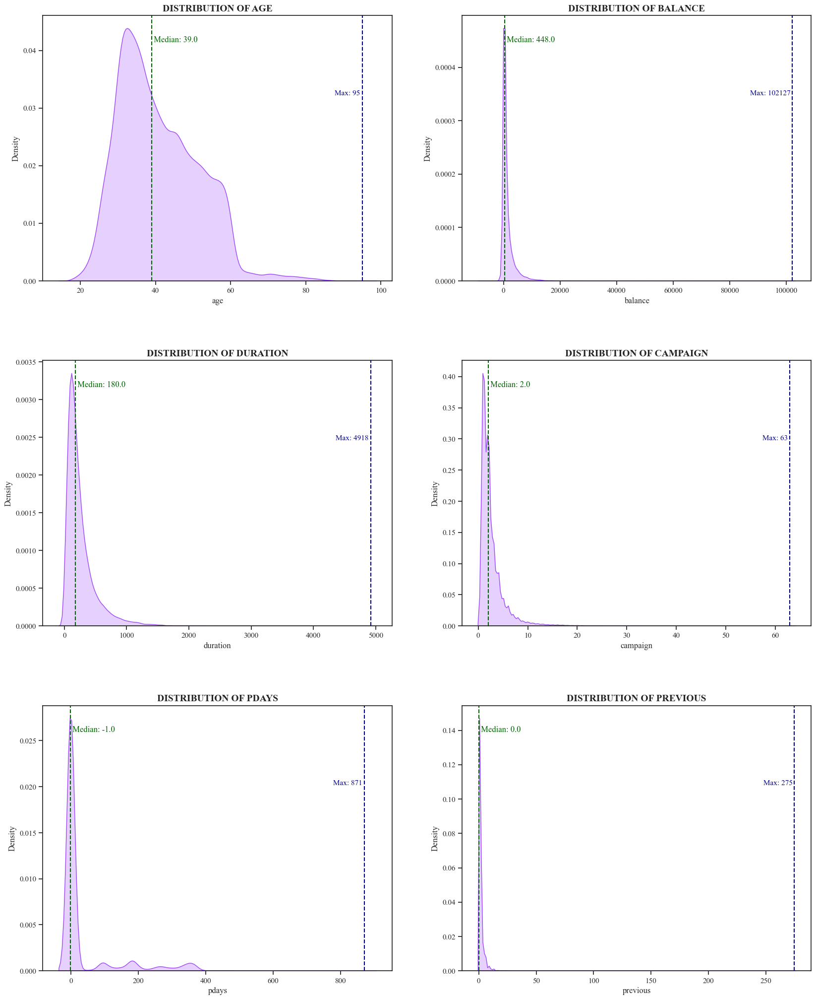

In [21]:
sns.set_style('ticks')
mpl.rcParams['font.family'] = 'Times New Roman'

fig = plt.figure(figsize=(20,25))
spec = fig.add_gridspec(3,2)
spec.update(wspace=0.2,hspace=0.3)

sections = []
for row in range(3):
    for col in range(2):
        sec = fig.add_subplot(spec[row, col])
        sections.append(sec)
count = 0        
for feature in num_col:
    median_val = df[feature].median()
    max_val = df[feature].max()
    ax=sections[count]
    sns.kdeplot(data=df, x=feature, fill = True,color='#9b44fe',ax=ax)
    
    ax.axvline(median_val, color='darkgreen', linestyle='--')
    ax.text(median_val, ax.get_ylim()[1]*0.9, f' Median: {median_val}', color='darkgreen', fontsize=12, ha='left')

    ax.axvline(max_val, color='darkblue', linestyle='--', label=f'Max: {max_val:.2f}')
    ax.text(max_val, ax.get_ylim()[1]*0.7, f'Max: {max_val} ', color='darkblue', fontsize=11, ha='right')
    
    sections[count].set_title('DISTRIBUTION OF '+ feature.upper(), fontweight='bold', fontsize = 14)
    sections[count].set_xlabel(feature, fontsize=12)
    count+=1

plt.show()

## <span style="color:darkred">📌 Observation</span> 
1. Most of the clients are mid-aged i.e.**35-45**
2. Most of the customers have balance less than **10000**. There are very few customers who have borrowed money from the bank and have negative balance, few have huge bank balance
3. Most of the customers have been contacted **1-4 times** in this campaign and the duration of last call was between **1-3 minutes**
4. A large number of rows with **pdays = -1** and **previous = 0** together strongly indicates that many of the clients in this dataset are newly contacted

### Distribution of categorical features

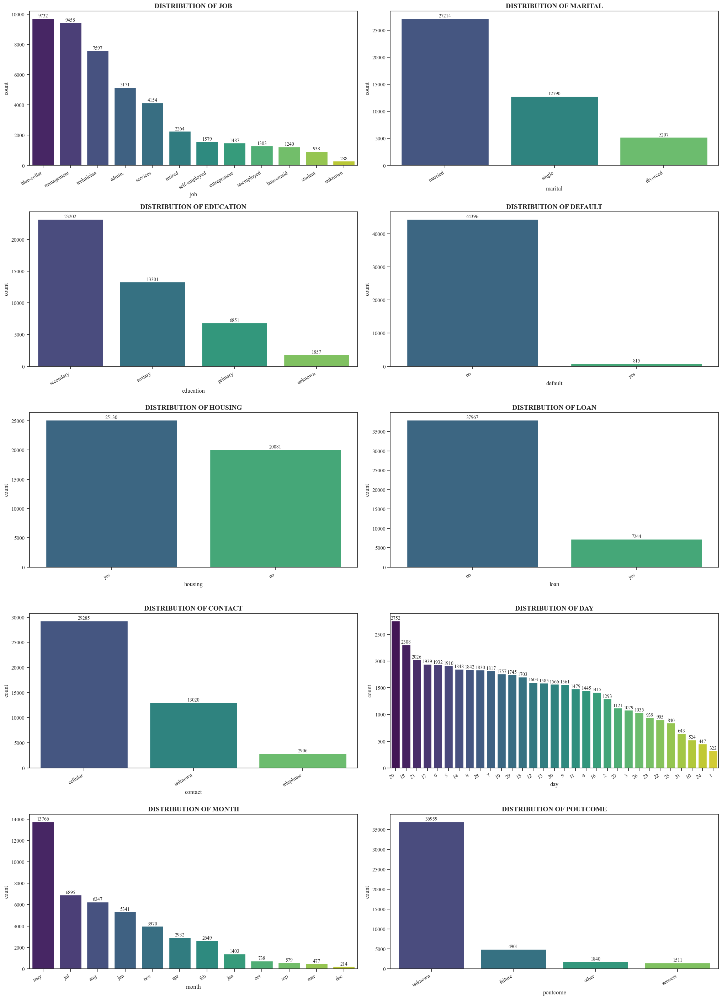

In [24]:
sns.set_style('ticks')
mpl.rcParams['font.family'] = 'Times New Roman'

fig = plt.figure(figsize=(25,35))
spec = fig.add_gridspec(5,2)
spec.update(wspace=0.1,hspace=0.3)

sections = []
for row in range(5):
    for col in range(2):
        sec = fig.add_subplot(spec[row, col])
        sections.append(sec)
count = 0        
for feature in cat_col[:-1]:
    ax=sections[count]
    sns.countplot(data=df, x=feature, palette="viridis", ax=ax, order=df[feature].value_counts().index)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')
    sections[count].set_title('DISTRIBUTION OF '+ feature.upper(), fontweight='bold', fontsize = 14)
    for p in ax.patches:
     height = p.get_height()
     if height>0: 
      ax.text(p.get_x()+p.get_width()/2, height+0.5, f'{int(height)}', ha='center', va='bottom', fontsize=10)
    count+=1

In [25]:
fig.tight_layout()
fig.savefig("categorical_distributions.png", dpi=300, bbox_inches='tight')
plt.show()


## <span style="color:darkred">📌 Observation</span> 
1. **Most** of the customers are **married**, from **blue-collar** and **management** jobs, have contact mode **cellular** and have done **secondary education**.
4. **Large** number of customers have **housing loans** as they may be living far from homes due to their jobs.
5. Very **few** customers have taken **personal loans**, some may have taken to **repay their previous loans (defaults)** and there are some entrepreneurs and self employed clients, they may have taken for some **startups**.
6. Most of the calls were scheduled between **May-Aug** in this dataset. Quarterly or half-yearly performance targets might drive campaigns in Q2/Q3.
7. **Least** number of **calls** were scheduled during **March and December**. Banks may avoid campaigns in months like December (holidays) or March (financial year-end in India).
8. **Majority** of the **marketing contacts** were scheduled **mid-late mid part** of month i.e. **17-21**. It might be because of historical success patterns, where these days performed better.

### Distribution of target variable

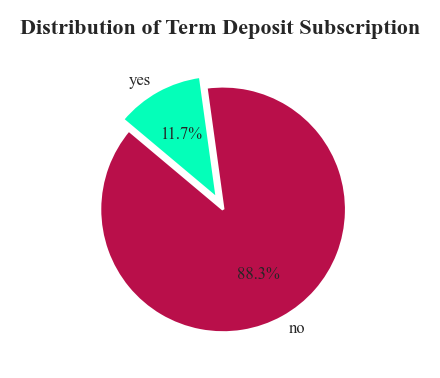

In [28]:
fig = plt.figure(figsize=(3,2), dpi=200)
mpl.rcParams['font.family'] = 'Times New Roman'
x = df['y'].value_counts().values
y = df['y'].value_counts().index
plt.pie(x,labels=y, autopct='%1.1f%%', colors=['#b90f4a','#04ffb9'],
        textprops={'fontsize': 6}, startangle=140, explode=(0.05, 0.05))
plt.title('Distribution of Term Deposit Subscription', fontsize='8', fontweight='semibold')

plt.show()

## <span style="color:darkred">📌 Observation</span>
* The dataset is **highly imbalanced**. Very few customers subscribes to term-deposits.

## Bivariate Analysis

### Creating new features for more detailed visualisation

In [32]:
df['age'].unique()

array([58, 44, 33, 47, 35, 28, 42, 43, 41, 29, 53, 57, 51, 45, 60, 56, 32,
       25, 40, 39, 52, 46, 36, 49, 59, 37, 50, 54, 55, 48, 24, 38, 31, 30,
       27, 34, 23, 26, 61, 22, 21, 20, 66, 62, 83, 75, 67, 70, 65, 68, 64,
       69, 72, 71, 19, 76, 85, 63, 90, 82, 73, 74, 78, 80, 94, 79, 77, 86,
       95, 81, 18, 89, 84, 87, 92, 93, 88])

In [33]:
df['age_group'] = np.where(df['age']<40, 'young_adult', np.where(df['age']< 60, 'mid_adult', 'old_adult'))
df['age_group'].value_counts()

age_group
young_adult    23362
mid_adult      20065
old_adult       1784
Name: count, dtype: int64

In [34]:
df['balance'].describe()

count     45211.000000
mean       1362.272058
std        3044.765829
min       -8019.000000
25%          72.000000
50%         448.000000
75%        1428.000000
max      102127.000000
Name: balance, dtype: float64

In [35]:
df['balance_group'] = np.where(df['balance']<0,'negative_balance',
                               np.where(df['balance']<10000, 'average_balance','rich_balance')) 
df['balance_group'].value_counts()

balance_group
average_balance     40616
negative_balance     3766
rich_balance          829
Name: count, dtype: int64

In [36]:
df['day'] = df['day'].astype('int')

In [37]:
df['day'] = np.where(df['day']<=10,'month_start',np.where(df['day'] <= 20, 'month_mid', 'month_end'))

In [38]:
df['day'] = df['day'].astype('category')
df['day'].value_counts()

day
month_mid      18389
month_start    13725
month_end      13097
Name: count, dtype: int64

### Distribution of clients based on age

In [40]:
def age_details(data):
    fig = px.box(data_frame=df, x=data, y='age', color=data, template='simple_white',title='<b>Distribution of age based on '+data)
    fig.update_layout(title_x=0.5,font_family="Times New Roman",legend_title_text=''+data)
    fig.show()


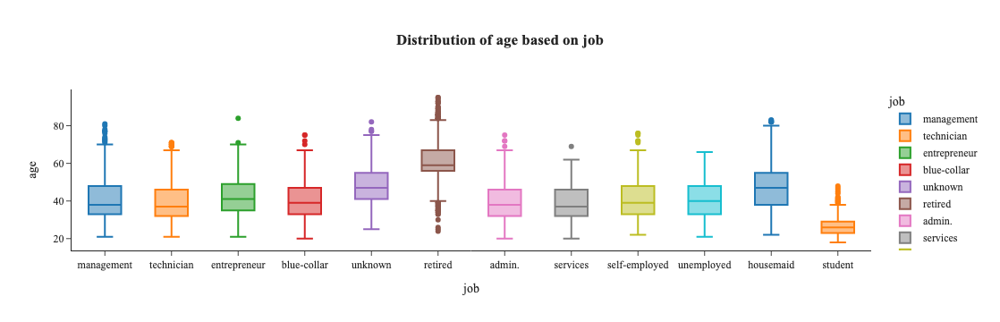

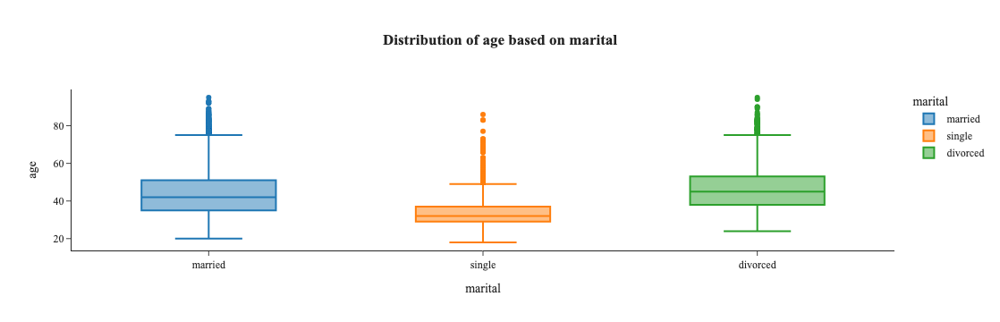

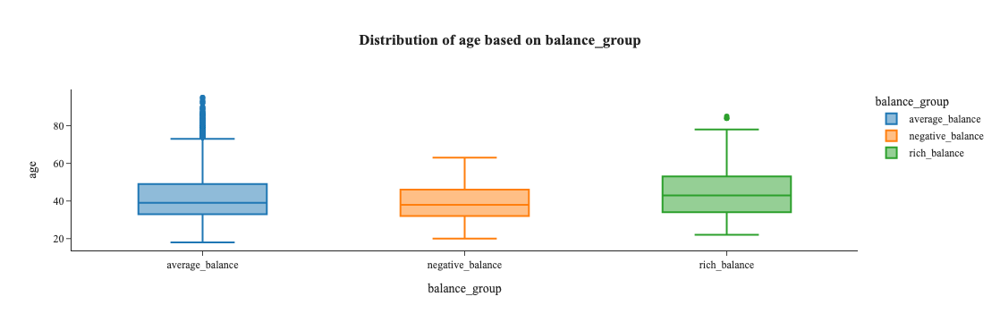

In [41]:
age_details('job')
age_details('marital')
age_details('balance_group')

## <span style="color:darkred">📌 Observation</span>
1. The **median age** of **rich** customers is **43** and customers with **negative balance** have median age of **38**. Also **no old customer** more than **63** years has negative balance, which suggests that the **age of most of rich customers are higher compared to average and negative ones**.

### Distribution of clients based on default status

In [44]:
def default_details(data):
    def_data = df.groupby([data, 'default']).size().reset_index(name='count')
    def_data['total'] = def_data.groupby(data)['count'].transform(sum)
    def_data['per'] = def_data['count']/def_data['total']*100
    def_data['percentage_label'] = def_data['per'].round(1).astype(str) + '%'
    
    fig = px.bar(def_data, x=data, y='count', template='simple_white', color='default', color_discrete_map={'yes': 'red', 'no': 'lightyellow'},
                 text='percentage_label', height=500, title='Distribution of defaults based on '+data)
    fig.update_layout(barmode='group',font_family= 'Times New Roman', title_x=0.5)
    fig.update_traces(textposition='outside')
    
    fig.show()


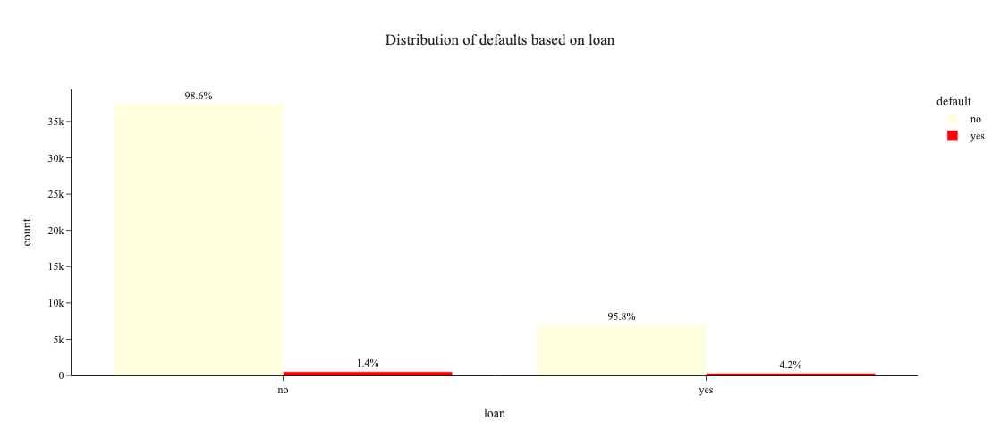

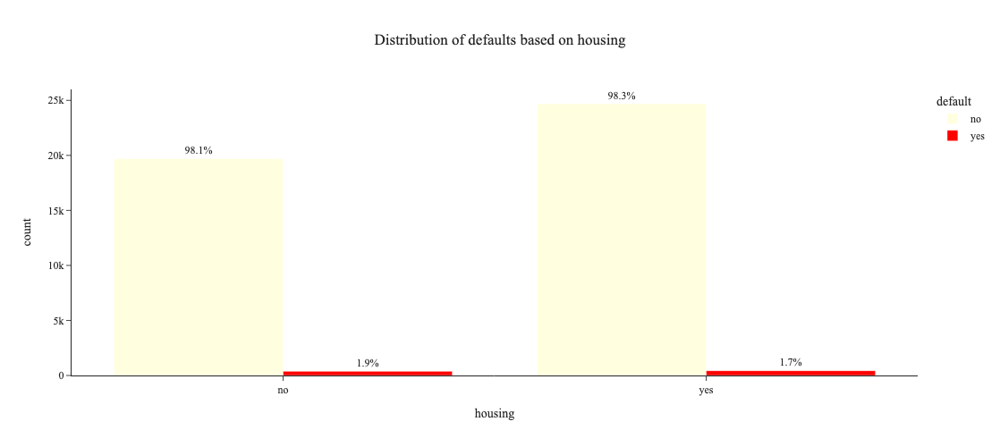

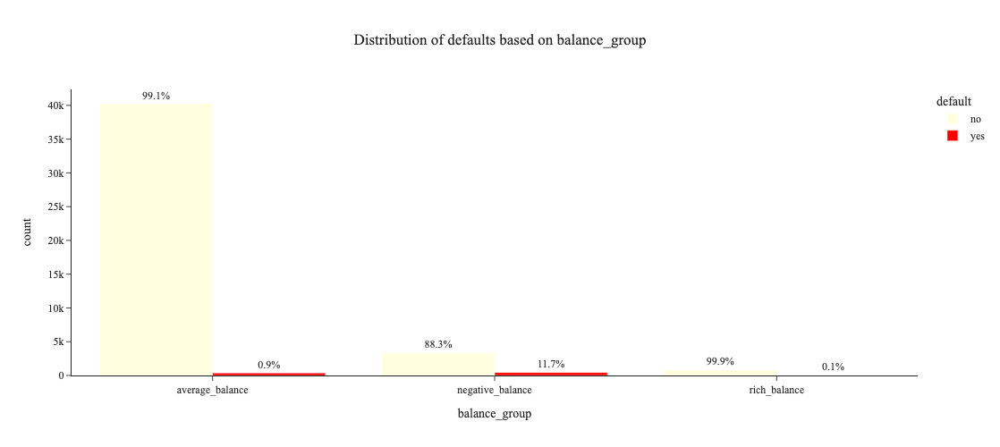

In [45]:
default_details('loan')
default_details('housing')
default_details('balance_group')

## <span style="color:darkred">📌 Observation</span>
1. **Most** of the **defaulters** have taken **personal loans** maybe to **repay** their **previous loans**, Also high percentage **defaulters** have **negative balance** in their bank account.

### Distribution of customers based on balance details

In [48]:
def balance_details(data):
    fig = px.violin(df, x=data,y='balance', color=data, template='simple_white', 
                 title='<b>Distribution of balance based on '+ data,range_y=(-10000,50000))
    fig.update_layout(title_x=0.5,font_family="Times New Roman",legend_title_text="<b>"+data)
    fig.show()

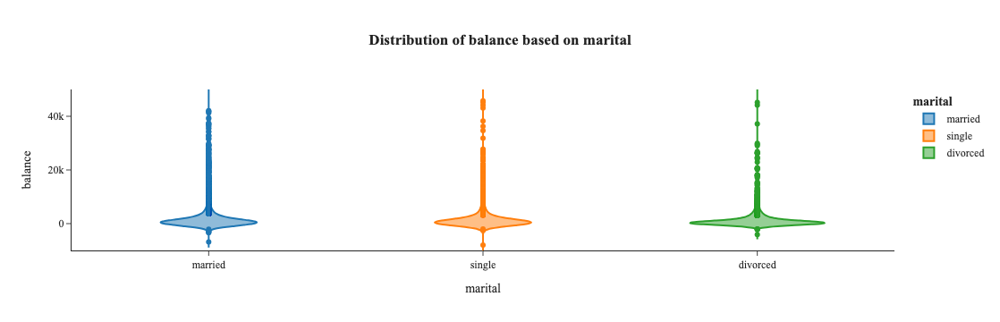

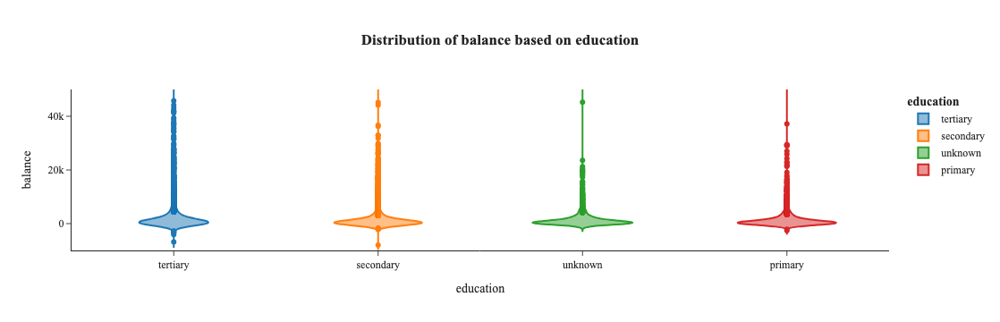

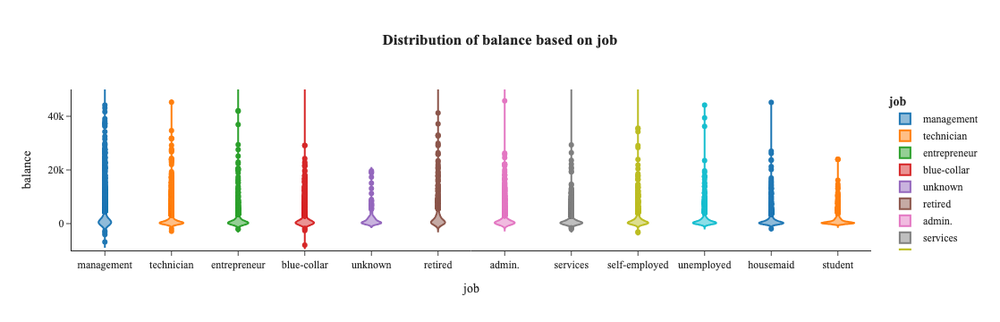

In [49]:
balance_details('marital')
balance_details('education')
balance_details('job')

## <span style="color:darkred">📌 Observation</span>
1. Divorced clients have low balance compare to married and single. This may be because the earning person has to pay divorce alimony.
2. The average customers with tertiary eduction have a little upper hand compared to primary and secondary.
3. Most of retired customers have higher balance compared to other jobs. This may be because of savings through the years. 

### Distribution of personal and housing loan based on different features

In [52]:
def loan_counts(data):
    df_loan = df[['loan', data]].value_counts().reset_index(name='personal_loan_counts')
    df_loan = df_loan.query("loan == 'yes'")
    
    df_housing = df[['housing', data]].value_counts().reset_index(name='housing_counts')
    df_housing = df_housing.query("housing == 'yes'")
    
    df_merge = pd.merge(df_loan[[data, 'personal_loan_counts']],df_housing[[data, 'housing_counts']],on=data,how='outer')
    
    df_melted = df_merge.melt(id_vars=data,value_vars=['personal_loan_counts', 'housing_counts'],
                              var_name='loan_type',value_name='count')
    
    df_melted['total'] = df_melted.groupby('loan_type')['count'].transform('sum')
    df_melted['percentage'] = 100 * df_melted['count'] / df_melted['total']
    df_melted['percentage_label'] = df_melted['percentage'].round(1).astype(str) + '%'
    
    fig = px.bar(df_melted, x=data, y='percentage', color='loan_type', text='percentage_label',template='simple_white',
                 color_discrete_map={'personal_loan_counts': 'purple', 'housing_counts': 'red'},height=500,
                 title=f'Loan Type Percentage Distribution across {data}')
    
    fig.update_layout(barmode='group', font_family='Times New Roman', title_x=0.5)
    fig.update_traces(textposition='outside')
    
    fig.show()


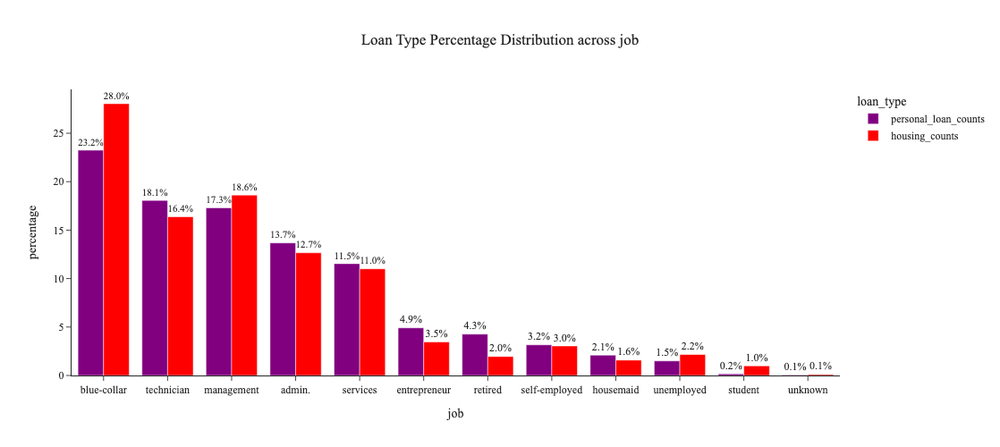

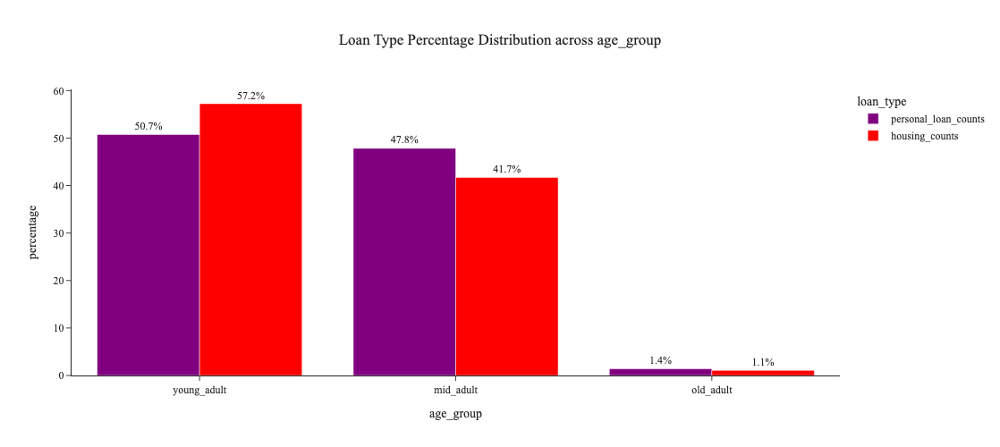

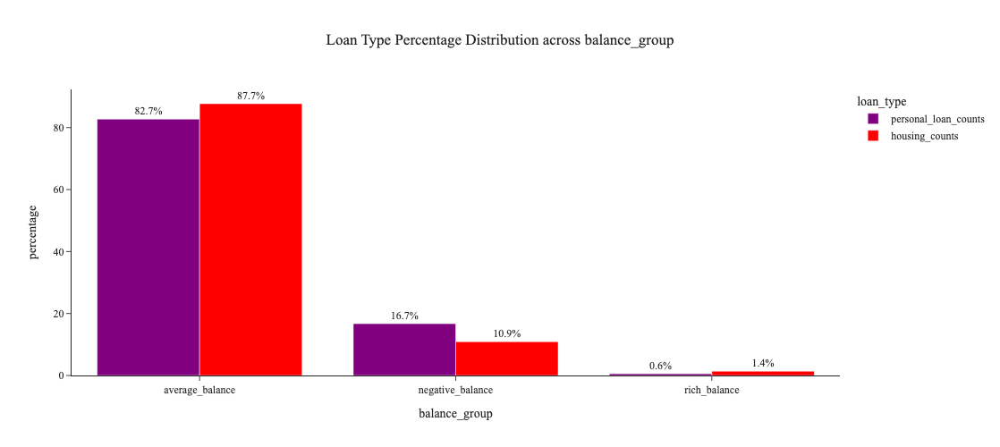

In [53]:
loan_counts('job')
loan_counts('age_group')
loan_counts('balance_group')

## <span style="color:darkred">📌 Observation</span>
1. More of **students, unemployed** have taken **housing loans**, as they might be wanting to invest early in housing. **Management and blue-collar workers** may see home ownership as a priority or stability goal. **Personal loans** being more common among other **job types (e.g., self-employed, entrepreneurs)** could indicate need for flexible credit or short-term liquidity.
2. **Young customers or singles** may be investing in early home ownership, often aided by family or with future planning in mind.
**Older or married clients** may have already purchased homes and now seek personal loans for renovation, education, or emergencies.

### Effect of features on term deposits 

In [56]:
def term_depo_loans(data):
    fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]],
                        subplot_titles=['With Loan', 'Without Loan'])
    
    with_loan = df[df[data] == 'yes']['y'].value_counts()
    fig.add_trace(go.Pie(labels=with_loan.index, values=with_loan.values, name="With Loan",
                         hole=0.9, marker_colors=['maroon','yellowgreen']),row=1, col=1)
    
    without_loan = df[df[data] == 'no']['y'].value_counts()
    fig.add_trace(go.Pie(labels=without_loan.index, values=without_loan.values, name="Without Loan",hole=0.9),
                  row=1, col=2)
    
    fig.update_layout(title_text='Term Deposit Subscription by '+data+' Status',title_x=0.5,font_family= 'Times New Roman',
                     annotations=[dict(text='With Loan', x=0.8, y=0.5, font_size=14, showarrow=False),
                                  dict(text='Without Loan', x=0.2, y=0.5, font_size=14, showarrow=False)])
    
    fig.show()


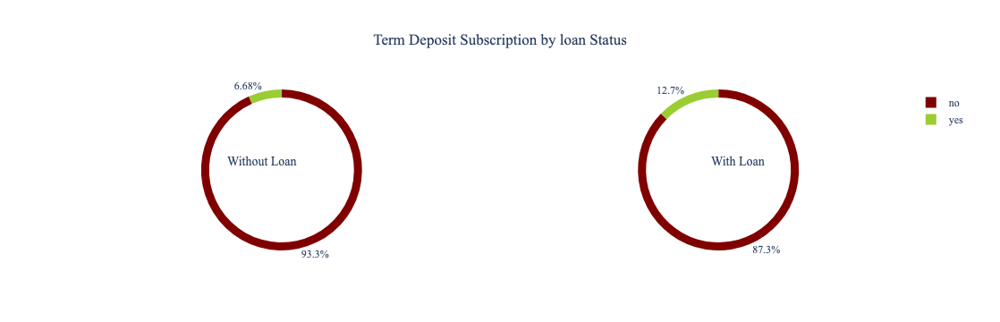

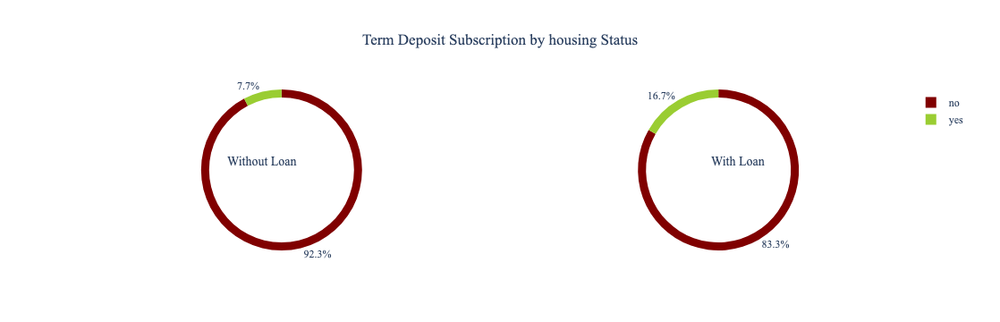

In [57]:
term_depo_loans('loan')
term_depo_loans('housing')

## <span style="color:darkred">📌 Observation</span>
1. Customers with **existing loans (personal or housing)** are more likely to **subscribe to a term deposit** compared to those without loans.

In [59]:
def term_depo_details(data):
    term_depo_data = df.groupby([data, 'y']).size().reset_index(name='count')
    term_depo_data['total'] = term_depo_data.groupby(data)['count'].transform(sum)
    term_depo_data['per'] = term_depo_data['count']/term_depo_data['total']*100
    term_depo_data['percentage_label'] = term_depo_data['per'].round(1).astype(str) + '%'
    
    fig = px.bar(term_depo_data, data,'count','y', text='percentage_label', color_discrete_map={'yes': 'yellow', 'no': 'lightgrey'},
                 title='Distribution of term deposits based on '+data, template='simple_white',height=500)
    fig.update_layout(barmode='group',font_family= 'Times New Roman', title_x=0.5, legend_title_text='Deposit')
    fig.update_traces(textposition='outside')

    fig.show()


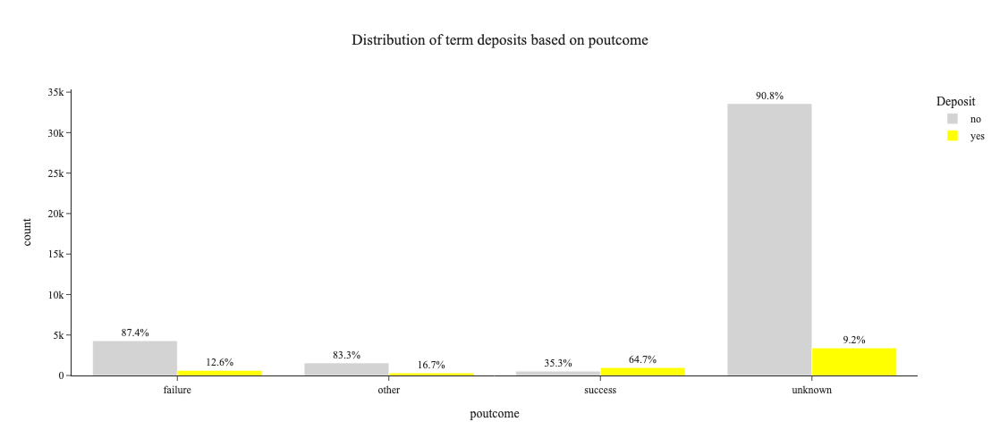

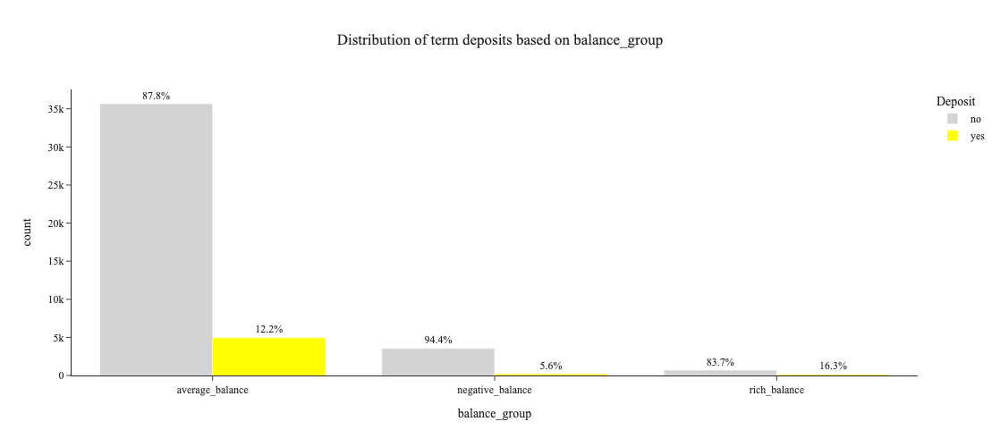

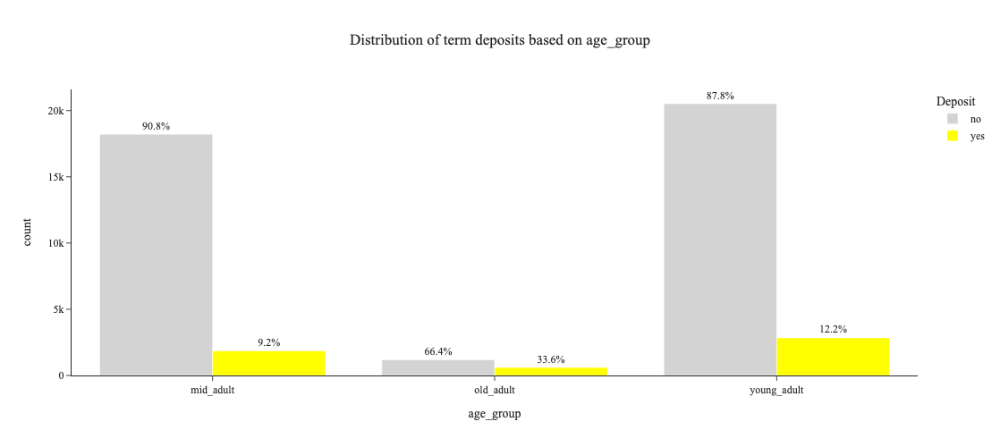

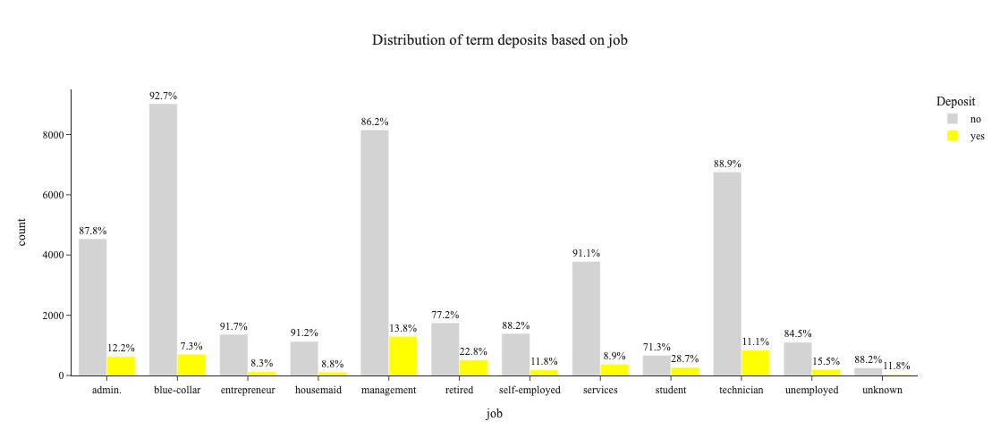

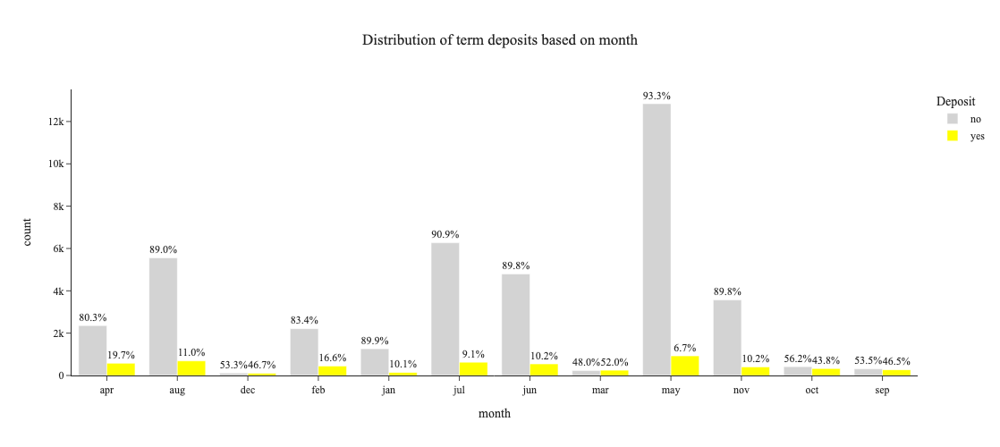

In [60]:
term_depo_details('poutcome')
term_depo_details('balance_group')
term_depo_details('age_group')
term_depo_details('job')
term_depo_details('month')

## <span style="color:darkred">📌 Observation</span>
1. Customers with **higher success rates** in previous campaign are more likely to **subscribe the term deposit**.
2. **Rich customers** are more **likely to subscribe** followed by average balance customers then negative balance customers.
3. **Old adults** are more likely to subscribe the term deposit.
4. **Students and retired customers** are more likely to subscribe the term deposit.
5. **Highest conversion rate** were seen in months like **Dec, Mar, Oct and Sept**.

In [62]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,age_group,balance_group
0,58,management,married,tertiary,no,2143,yes,no,unknown,month_start,may,261,1,-1,0,unknown,no,mid_adult,average_balance
1,44,technician,single,secondary,no,29,yes,no,unknown,month_start,may,151,1,-1,0,unknown,no,mid_adult,average_balance
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,month_start,may,76,1,-1,0,unknown,no,young_adult,average_balance
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,month_start,may,92,1,-1,0,unknown,no,mid_adult,average_balance
4,33,unknown,single,unknown,no,1,no,no,unknown,month_start,may,198,1,-1,0,unknown,no,young_adult,average_balance


In [63]:
data = df.groupby(['campaign','y']).size().reset_index(name='count')
data

,campaign,y,count
0,1,no,14983
1,1,yes,2561
2,2,no,11104
3,2,yes,1401
4,3,no,4903
...,...,...,...
91,55,yes,0
92,58,no,1
93,58,yes,0
94,63,no,1


In [64]:
def campaign_effect(df1):
    data = df.groupby([df1,'y']).size().reset_index(name='count')
    fig = px.line(data, x=df1,y='count',color='y',template='simple_white', title="Effect of "+df1+" on term-deposit",
           color_discrete_map={'yes': 'darkgreen', 'no': 'orangered'})
    fig.update_layout(barmode='group',font_family= 'Times New Roman', title_x=0.5, legend_title_text='Deposit')
    fig.show()

#### Effect of campaign on term-deposits

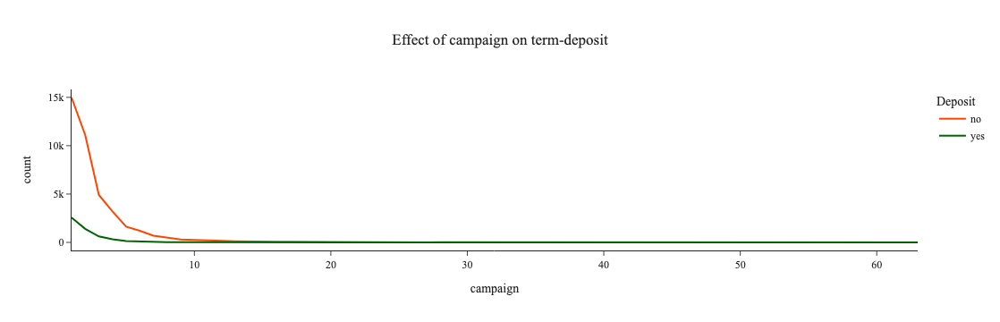

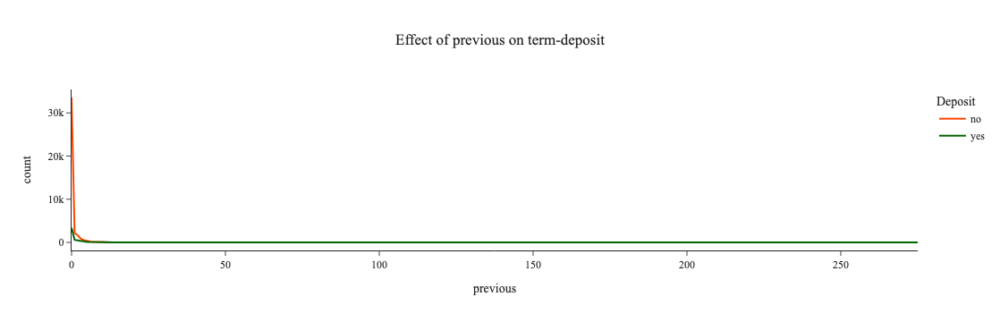

In [66]:
campaign_effect('campaign')
campaign_effect('previous')

## <span style="color:darkred">📌 Observation</span>
1. From the analysis, with the **increase in contacts** performed for the clients in the **current and previous campaign** there is more chance for the client to **unsubscribe the term deposit**. It is better to perform **less contacts** to the client to make them **subscribe** to the term deposits

#### Effect of pdays and duration on term deposit

In [69]:
def depo_details(data):
    fig=px.box(df,x='y',y=data,color='y',template='simple_white',color_discrete_sequence=['darkgrey','deeppink'],
               title='<b>Effect of'+data+' on Term Deposit Status')
    fig.update_layout(title_x=0.5,font_family="Times New Roman",legend_title_text="<b>Term Deposit")
    fig.show()

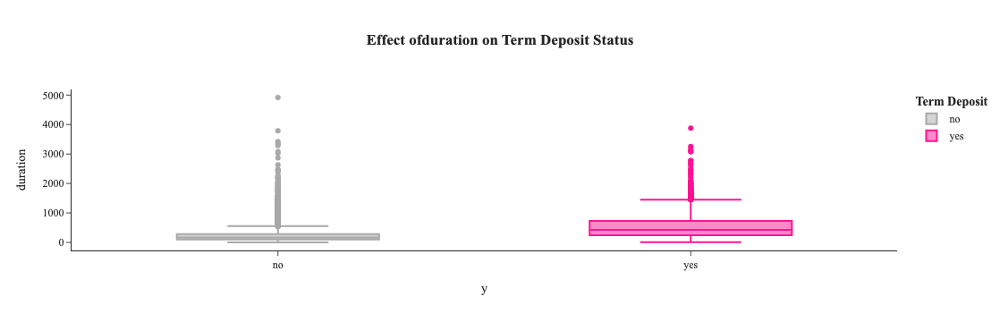

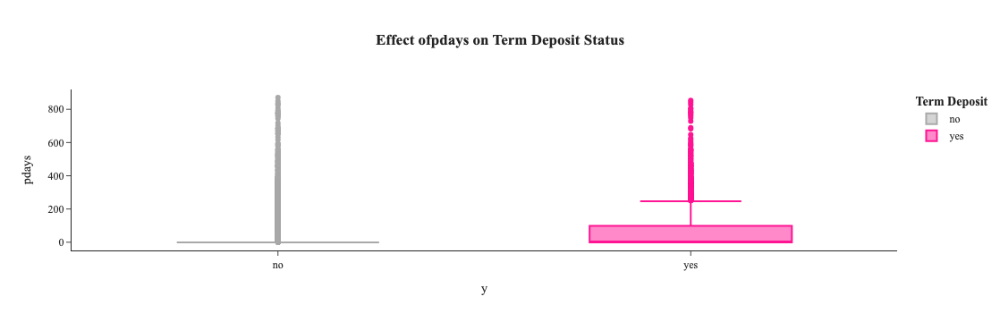

In [70]:
depo_details('duration')
depo_details('pdays')

## <span style="color:darkred">📌 Observation</span>
1. **Higher the duration** of the last call, more likely the **customer will subscribe** to term deposit.
2. Customers who have **never been contacted** are more likely to **unsubscribe the term deposit**.

### Correlation matrix

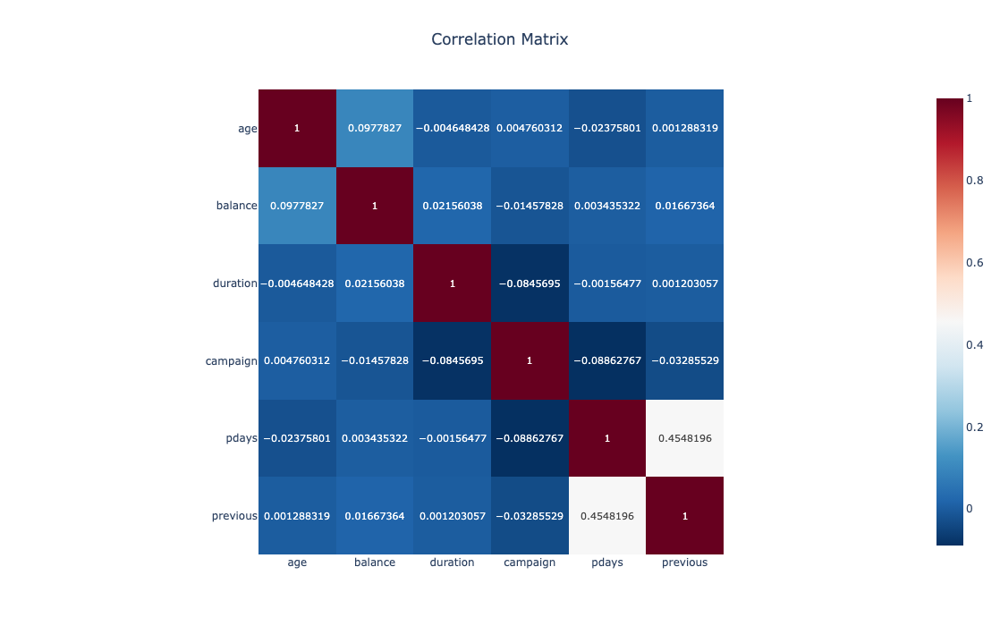

In [73]:
corr_matrix = df[num_col].corr()

fig = px.imshow(corr_matrix,text_auto=True,color_continuous_scale='RdBu_r',
                title="Correlation Matrix")
fig.update_layout(width=800, height=700, title_x=0.5)
fig.show()

In [74]:
fig.write_image("correlation_matrix.png", scale=2)

## <span style="color:darkred">📌 Observation</span>
1. There is no multicollinearity between the features.

## Feature Transformation

In [77]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,age_group,balance_group
0,58,management,married,tertiary,no,2143,yes,no,unknown,month_start,may,261,1,-1,0,unknown,no,mid_adult,average_balance
1,44,technician,single,secondary,no,29,yes,no,unknown,month_start,may,151,1,-1,0,unknown,no,mid_adult,average_balance
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,month_start,may,76,1,-1,0,unknown,no,young_adult,average_balance
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,month_start,may,92,1,-1,0,unknown,no,mid_adult,average_balance
4,33,unknown,single,unknown,no,1,no,no,unknown,month_start,may,198,1,-1,0,unknown,no,young_adult,average_balance


In [78]:
df['pdays'].value_counts().reset_index().iloc[0:2]

,pdays,count
0,-1,36954
1,182,167


- For pdays , there are almsot 37k data where the client was never contacted before so we will try to transform this feature as categorical column ('was_contacted_before') and will try to understand if contacting a client is impacting the counts of term deposits or not. 

In [80]:
df['was_contacted_before'] = np.where(df['pdays'] != -1, 'yes', 'no')
df['was_contacted_before'] = df['was_contacted_before'].astype('category')

In [81]:
# Dropping pdays
df.drop('pdays', axis=1, inplace=True)

In [82]:
#Dropping features which were created and used for data visualization
df.drop(['balance_group','age_group'], axis=1, inplace=True)

In [83]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,previous,poutcome,y,was_contacted_before
0,58,management,married,tertiary,no,2143,yes,no,unknown,month_start,may,261,1,0,unknown,no,no
1,44,technician,single,secondary,no,29,yes,no,unknown,month_start,may,151,1,0,unknown,no,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,month_start,may,76,1,0,unknown,no,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,month_start,may,92,1,0,unknown,no,no
4,33,unknown,single,unknown,no,1,no,no,unknown,month_start,may,198,1,0,unknown,no,no


## Outlier Treatement (Winsorization)

### <span style="color:darkgreen">🔍 Important point</span>
- In **balance💰**, we are **not treating the outliers** as there can be **clients whose balance are negative** and who are **extremely rich** which are important factors for term deposits.

In [86]:
print(df['campaign'].quantile(0.99))
print(df['previous'].quantile(0.99))
print(df['duration'].quantile(0.99))

16.0
8.900000000001455
1269.0


- #### We will clip the rest values above **99.7%** 

In [88]:
def winsorizer(data):
    q1 = df[data].quantile(0.99)
    df[data] = np.where(df[data]>q1,q1,df[data])

In [89]:
winsorizer('campaign')
winsorizer('previous')
winsorizer('duration')

## Encoding (Label and One-hot encoding)

In [91]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,previous,poutcome,y,was_contacted_before
0,58,management,married,tertiary,no,2143,yes,no,unknown,month_start,may,261.0,1.0,0.0,unknown,no,no
1,44,technician,single,secondary,no,29,yes,no,unknown,month_start,may,151.0,1.0,0.0,unknown,no,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,month_start,may,76.0,1.0,0.0,unknown,no,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,month_start,may,92.0,1.0,0.0,unknown,no,no
4,33,unknown,single,unknown,no,1,no,no,unknown,month_start,may,198.0,1.0,0.0,unknown,no,no


In [92]:
label_encoded_col = []
onehot_encoded_col = []
for i in df.select_dtypes(include='category').columns:
    if df[i].nunique() == 2:
        label_encoded_col.append(i)
    else:
        onehot_encoded_col.append(i)

In [93]:
onehot_encoded_col

['job', 'marital', 'education', 'contact', 'day', 'month', 'poutcome']

In [94]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
for i in label_encoded_col:
    df[i] = le.fit_transform(df[i])

In [95]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,previous,poutcome,y,was_contacted_before
0,58,management,married,tertiary,0,2143,1,0,unknown,month_start,may,261.0,1.0,0.0,unknown,0,0
1,44,technician,single,secondary,0,29,1,0,unknown,month_start,may,151.0,1.0,0.0,unknown,0,0
2,33,entrepreneur,married,secondary,0,2,1,1,unknown,month_start,may,76.0,1.0,0.0,unknown,0,0
3,47,blue-collar,married,unknown,0,1506,1,0,unknown,month_start,may,92.0,1.0,0.0,unknown,0,0
4,33,unknown,single,unknown,0,1,0,0,unknown,month_start,may,198.0,1.0,0.0,unknown,0,0


In [96]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(sparse_output=False, drop='first')
arr = ohe.fit_transform(df[onehot_encoded_col])
encoded_df = pd.DataFrame(arr, columns=ohe.get_feature_names_out(onehot_encoded_col), index=df.index)
df.drop(onehot_encoded_col, axis=1, inplace=True)
df = pd.concat([df,encoded_df], axis=1)

In [97]:
df.head()

,age,default,balance,housing,loan,duration,campaign,previous,y,was_contacted_before,...,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,poutcome_other,poutcome_success,poutcome_unknown
0,58,0,2143,1,0,261.0,1.0,0.0,0,0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,44,0,29,1,0,151.0,1.0,0.0,0,0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2,33,0,2,1,1,76.0,1.0,0.0,0,0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,47,0,1506,1,0,92.0,1.0,0.0,0,0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
4,33,0,1,0,0,198.0,1.0,0.0,0,0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0


## Splitting the data

In [99]:
x = df.drop(columns=['y'], axis=1)
y = df['y']   

In [100]:
x.shape

(45211, 43)

In [101]:
y.shape

(45211,)

In [102]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2,stratify=y,random_state=42)

In [103]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(36168, 43)
(9043, 43)
(36168,)
(9043,)


## Feature Scaling (Robust Scaling)

### <span style="color:darkgreen">🔍 Important point </span>
- Using robust scaling to transform data, which will help to lower the skewness and works well with negative data.

In [106]:
from sklearn.preprocessing import RobustScaler

In [107]:
rc = RobustScaler()
x_scaled = rc.fit_transform(x_train[['age','balance','campaign','previous','duration']])

In [108]:
x_scaled = pd.DataFrame(x_scaled, columns=['age','balance','campaign','previous','duration'], index=x_train.index)

In [109]:
x_train.drop(['age','balance','campaign','previous','duration'], axis=1, inplace=True)

In [110]:
x_train_scaled = pd.concat([x_train,x_scaled],axis=1)

In [111]:
x_train_scaled.head()

,default,housing,loan,was_contacted_before,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,...,month_oct,month_sep,poutcome_other,poutcome_success,poutcome_unknown,age,balance,campaign,previous,duration
24001,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.200000,0.302304,0.0,0.0,-0.186047
43409,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,-1.000000,2.709677,1.0,7.0,3.381395
20669,0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.333333,-0.152627,1.0,0.0,5.065116
18810,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.600000,-0.332535,4.5,0.0,-0.674419
23130,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.066667,-0.143041,4.0,0.0,-0.572093


## Data Imbalance Treatement (SMOTE-FOR OVERSAMPLING)

In [113]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42, sampling_strategy=0.6)
x_resample, y_resample = sm.fit_resample(x_train_scaled,y_train)

In [114]:
y_resample.value_counts()

y
0    31937
1    19162
Name: count, dtype: int64

# Model Building (Classification Problem)

In [116]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, precision_recall_curve, average_precision_score, roc_curve
from sklearn.model_selection import cross_val_score, GridSearchCV
import time

## Transforming test data for prediction

In [118]:
x_test_scaled = rc.transform(x_test[['age','balance','campaign','previous','duration']])
x_test_scaled = pd.DataFrame(x_test_scaled, columns=['age','balance','campaign','previous','duration'], index=x_test.index)
x_test.drop(['age','balance','campaign','previous','duration'], axis=1, inplace=True)
x_test_scaled = pd.concat([x_test,x_test_scaled],axis=1)
x_test_scaled

,default,housing,loan,was_contacted_before,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,...,month_oct,month_sep,poutcome_other,poutcome_success,poutcome_unknown,age,balance,campaign,previous,duration
1392,0,1,1,0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.066667,0.139355,0.0,0.0,0.776744
7518,0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.333333,-0.053825,0.0,0.0,0.106977
12007,0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.533333,-0.070046,1.5,0.0,0.223256
5536,0,1,0,0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.200000,0.150415,1.0,0.0,-0.125581
29816,0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.333333,1.083871,-0.5,0.0,-0.553488
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12636,0,0,1,0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.866667,-0.578065,-0.5,0.0,2.381395
13364,0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.666667,0.319263,0.5,0.0,0.097674
16102,0,1,0,0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.466667,0.378249,0.0,0.0,0.883721
42097,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,-1.266667,-0.332535,1.0,4.0,-0.516279


In [120]:
models = {
    'LogitReg': LogisticRegression(random_state=42),
    'DT': DecisionTreeClassifier(random_state=42),
    'RF': RandomForestClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
    'GradientBoost' : GradientBoostingClassifier(random_state=42),
    'XGBoost': XGBClassifier(random_state=42),
    'GNB': GaussianNB(),
    'BNB' : BernoulliNB()
}

train_accuracies = []
test_accuracies = []
training_time = []
model_names = []
precisions = []
recalls = []

for name, model in models.items():
    starttime = time.time()
    model.fit(x_resample, y_resample)
    endtime = time.time()
    training_time.append(endtime-starttime)
    y_train_pred = model.predict(x_resample)
    y_test_pred = model.predict(x_test_scaled)
    
    train_acc = accuracy_score(y_resample, y_train_pred)
    test_acc = accuracy_score(y_test, y_test_pred)
    precision = precision_score(y_test,y_test_pred)
    recall = recall_score(y_test,y_test_pred)

    model_names.append(name)
    train_accuracies.append(train_acc)
    test_accuracies.append(test_acc)
    precisions.append(precision)
    recalls.append(recall)


# Create accuracy DataFrame
df_accuracy = pd.DataFrame({
    'Model Name': model_names,
    'Train Accuracy': train_accuracies,
    'Test Accuracy': test_accuracies,
    'Training Time': training_time,
    'Precision': precisions,
    'Recall': recalls
})
print(df_accuracy)

      Model Name  Train Accuracy  Test Accuracy  Training Time  Precision  \
0       LogitReg        0.848177       0.878138       0.492957   0.485733   
1             DT        1.000000       0.866858       0.411415   0.442700   
2             RF        1.000000       0.902245       3.743569   0.596882   
3       AdaBoost        0.887219       0.887206       1.528850   0.515152   
4  GradientBoost        0.908296       0.894725       6.699184   0.540707   
5        XGBoost        0.957025       0.903019       0.526417   0.597627   
6            GNB        0.770446       0.832025       0.021792   0.362059   
7            BNB        0.756923       0.808139       0.029548   0.324884   

     Recall  
0  0.707940  
1  0.533081  
2  0.506616  
3  0.610586  
4  0.665406  
5  0.523629  
6  0.571834  
7  0.593573  


### <span style="color:darkgreen">🔍 Important point </span>
1. From all the above algorithms choosing **xg boost** as final algorithm, As it i giving one of the **best metrics values** with **less training time**

In [123]:
# Cross validating the training data 
xgb = XGBClassifier(random_state=42)
xgb.fit(x_resample,y_resample)
cross_val_score(xgb, x_train_scaled, y_train, cv=10)

array([0.90295825, 0.90157589, 0.90019353, 0.90268178, 0.90185236,
       0.9035112 , 0.90185236, 0.9134642 , 0.90707965, 0.9068031 ])

### <span style="color:darkgreen">🔍 Important point </span>
- The model demonstrates stable and strong performance, with accuracies ranging from ~90.0% to ~91.3%, generalizes well across different subsets of the training data.

In [125]:
y_test_pred = xgb.predict(x_test_scaled)
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       0.94      0.95      0.95      7985
           1       0.60      0.52      0.56      1058

    accuracy                           0.90      9043
   macro avg       0.77      0.74      0.75      9043
weighted avg       0.90      0.90      0.90      9043



## Hyperparameter Tuning (Grid Search CV)

In [127]:
params = {
    'n_estimators': [100, 150],
    'max_depth': [3, 4],
    'learning_rate': [0.08, 0.1],
    'subsample': [0.8, 0.9],
    'colsample_bytree': [0.8, 0.9]
}

In [128]:
xgb = XGBClassifier(random_state=42, eval_metric='logloss')
scoring = {
    'average_precision': 'average_precision',
    'roc_auc': 'roc_auc',
    'f1': 'f1',
}
grid= GridSearchCV(estimator=xgb, param_grid=params, refit='average_precision',
                            scoring=scoring,n_jobs=-1)
grid.fit(x_resample,y_resample)
print(grid.best_params_)

{'colsample_bytree': 0.9, 'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 150, 'subsample': 0.8}


In [129]:
xgb = XGBClassifier(n_estimators= 150 ,max_depth= 4, learning_rate= 0.1 ,subsample= 0.8,colsample_bytree= 0.9)
xgb.fit(x_resample,y_resample)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=150, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [130]:
y_train_pred = xgb.predict(x_resample)
y_test_pred = xgb.predict(x_test_scaled)

In [131]:
train_acc = accuracy_score(y_resample, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)
print('Training Accuracy: ',train_acc)
print('Test Accuracy: ',test_acc)

Training Accuracy:  0.9281786336327521
Test Accuracy:  0.9043459029083268


In [132]:
y_test_pred = xgb.predict(x_test_scaled)
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       0.95      0.94      0.95      7985
           1       0.59      0.61      0.60      1058

    accuracy                           0.90      9043
   macro avg       0.77      0.78      0.77      9043
weighted avg       0.91      0.90      0.91      9043



### <span style="color:darkgreen">🔍 Important point </span>
- **Tuning** helped in **lowering the variance** and slightly **increasing recall and precision**

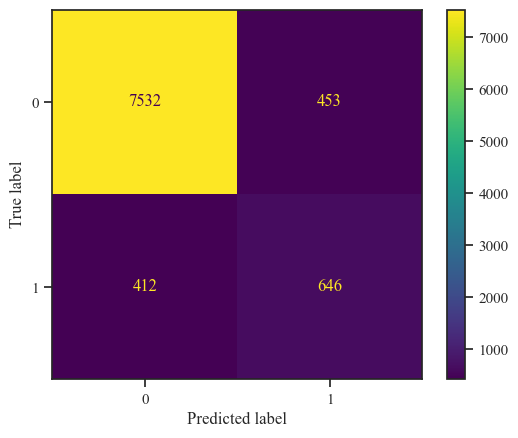

In [134]:
cm = confusion_matrix(y_test, y_test_pred)
ConfusionMatrixDisplay(cm, display_labels=xgb.classes_).plot()

plt.show()

In [138]:
# Cross validating the test data
Cross_val = cross_val_score(xgb, x_test_scaled, y_test, cv=10).mean()   
print("Cross-Validation Accuracy Scores Decision Tree : ",Cross_val*100)

Cross-Validation Accuracy Scores Decision Tree :  89.8707280105608


## Dimensionality Reduction (Feature Selection of tuned model)

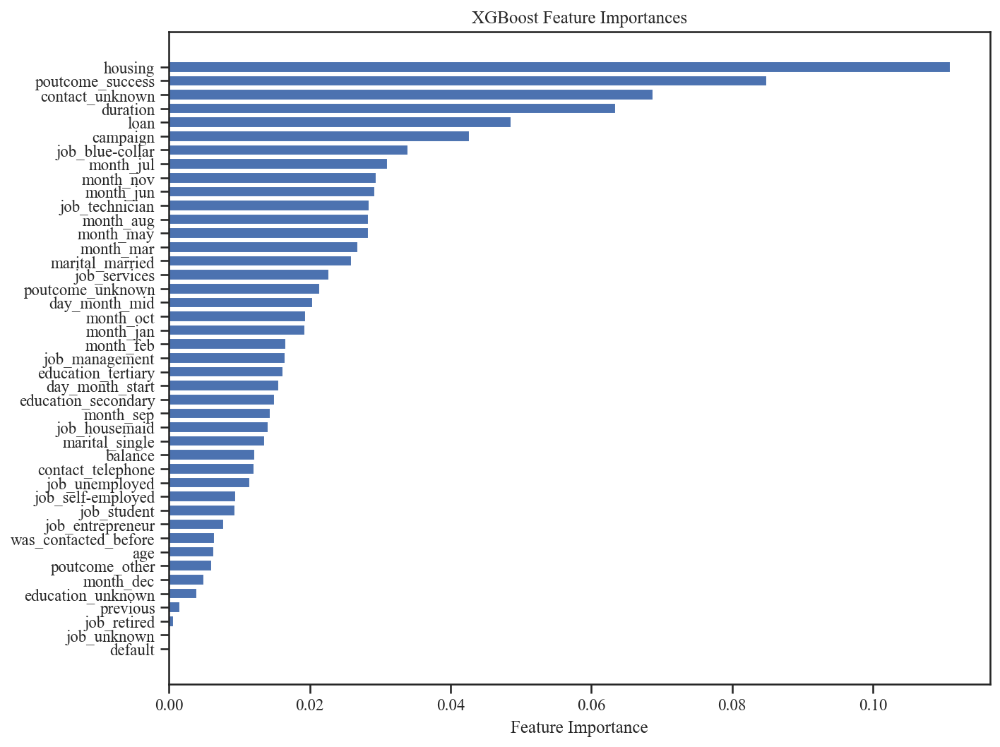

In [140]:
importances = xgb.feature_importances_
feature_names = x_resample.columns  # make sure X is a pandas DataFrame

# Create a sorted bar chart
sorted_idx = np.argsort(importances)[::-1]
plt.figure(figsize=(10, 8), dpi=150)
plt.barh(range(len(importances)), importances[sorted_idx], align='center')
plt.yticks(range(len(importances)), feature_names[sorted_idx])
plt.xlabel("Feature Importance")
plt.title("XGBoost Feature Importances")
plt.gca().invert_yaxis()

plt.show()

In [141]:
low_importance_features = [
    'day_month_start','education_secondary','month_sep',
    'job_housemaid','marital_single','balance','contact_telephone','job_unemployed','job_self-employed','job_student', 
    'job_entrepreneur','was_contacted_before','age','poutcome_other','month_dec',
    'education_unknown','previous','job_retired','job_unknown', 'default'
]

x_train_impfeats = x_resample.drop(columns=low_importance_features)
x_test_impfeats = x_test_scaled.drop(columns=low_importance_features)

In [142]:
x_test_impfeats

,housing,loan,job_blue-collar,job_management,job_services,job_technician,marital_married,education_tertiary,contact_unknown,day_month_mid,...,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,poutcome_success,poutcome_unknown,campaign,duration
1392,1,1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.776744
7518,1,0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.106977
12007,1,0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.5,0.223256
5536,1,0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,-0.125581
29816,1,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,-0.5,-0.553488
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12636,0,1,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,-0.5,2.381395
13364,1,0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.5,0.097674
16102,1,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.883721
42097,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,-0.516279


## Fitting the model with reduced features

### Base Model

In [145]:
xgb = XGBClassifier(n_estimators= 150 ,max_depth= 4, learning_rate= 0.1 ,
                    subsample= 0.8,colsample_bytree= 0.9,random_state=42)
xgb.fit(x_train_impfeats,y_resample)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=150, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [146]:
y_train_pred = xgb.predict(x_train_impfeats)
y_test_pred = xgb.predict(x_test_impfeats)

In [147]:
train_acc = accuracy_score(y_resample, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)
print('Training Accuracy: ',train_acc)
print('Test Accuracy: ',test_acc)

Training Accuracy:  0.9205072506311278
Test Accuracy:  0.9015813336282207


In [148]:
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       0.95      0.94      0.94      7985
           1       0.57      0.62      0.60      1058

    accuracy                           0.90      9043
   macro avg       0.76      0.78      0.77      9043
weighted avg       0.90      0.90      0.90      9043



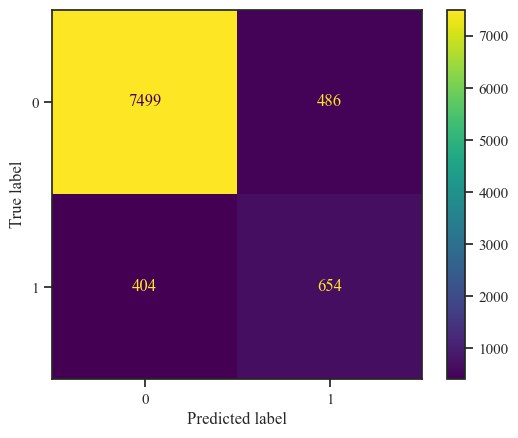

In [149]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_test_pred)
ConfusionMatrixDisplay(cm, display_labels=xgb.classes_).plot()
plt.show()

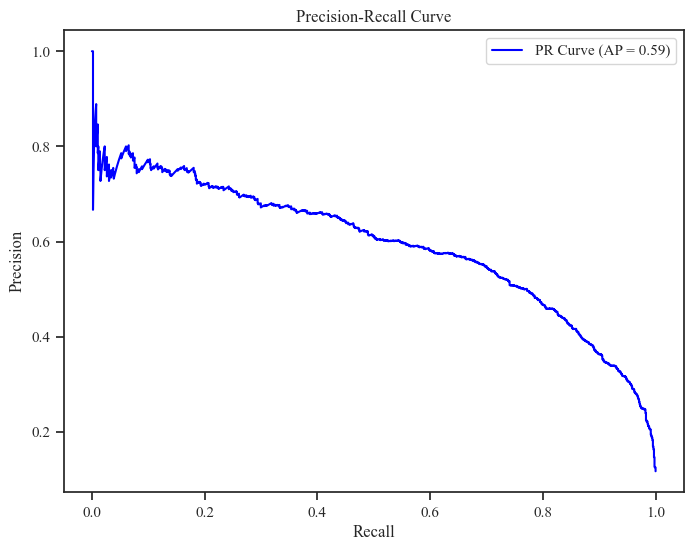

In [150]:
y_scores = xgb.predict_proba(x_test_impfeats)[:,1]
precision, recall, thresholds = precision_recall_curve(y_test, y_scores)
avg_precision = average_precision_score(y_test, y_scores)

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label=f'PR Curve (AP = {avg_precision:.2f})', color='blue')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()

plt.show()

#### Saving Base model Prediction

In [152]:
basemodel_predictions = pd.DataFrame({
    'Customer_ID': x_test_impfeats.index,
    'Predicted_Label': y_test_pred
})
# basemodel_predictions.to_csv('base_model_prediction_TD.csv', index=False)

#### <span style="color:blue"> Precision-Recall Curve Analysis </span>

- The model achieves a **recall of 0.62** and a **precision of 0.57**, resulting in an **Average Precision (AP) score of 0.59**.
- This indicates that the model is able to identify **62% of actual subscribers** (true positives),and only **57% of the predicted subscribers** are actually correct.
-  In the context of a marketing campaign, this means the model is moderately effective at detecting potential term deposit subscribers, but there's a **notable number of false positives and false negatives**, which is just average in terms of **improving targeting for future campaigns and reducing marketing costs**.

### Precision-Recall Trade-Off

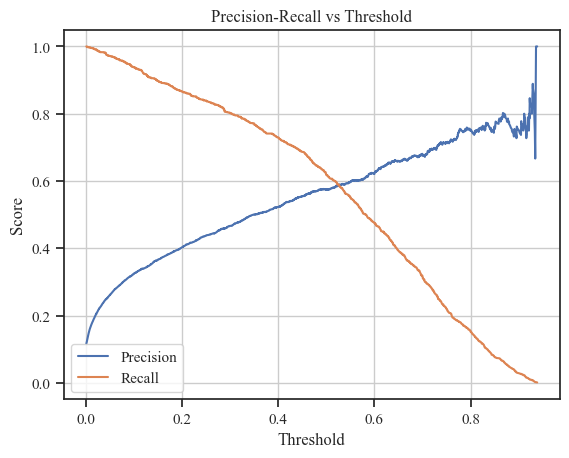

In [155]:
y_probs = xgb.predict_proba(x_test_impfeats)[:, 1]
prec, rec, thresholds = precision_recall_curve(y_test, y_probs)

# Plot the precision-recall curve
plt.plot(thresholds, prec[:-1], label='Precision')
plt.plot(thresholds, rec[:-1], label='Recall')
plt.xlabel('Threshold')
plt.ylabel('Score')
plt.legend()
plt.title('Precision-Recall vs Threshold')
plt.grid(True)

plt.show()